In [2]:
import xml.etree.ElementTree as ET
import os
from glob import glob
import cv2
import matplotlib.pyplot as plt
import tensorflow as tf
tf.__version__
%load_ext autoreload
%autoreload 2
import sys
sys.path.append("../..")
import cv2
import numpy as np
from glob import glob
from models import Yolov4

In [3]:
IMAGE_PATH = '../../dataset/train_orig_images/'

CLASSES_PATH = '../../class_names/butelka_classes.txt'
DEST_PATH = '../../dataset/butelka_wyciete_przez_niego/'

'''loads the classes'''
def get_classes(classes_path):
    with open(classes_path) as f:
        class_names = f.readlines()
    class_names = [c.strip() for c in class_names]
    return class_names


classes = get_classes(CLASSES_PATH)
assert len(classes) > 0, 'no class names detected!'
print(f'num classes: {len(classes)}')


num classes: 2


In [4]:
yolo_model = Yolov4(class_name_path='../../class_names/butelka_classes.txt')
yolo_model.load_model('../wagi')

Yolov4
(416, 416, 3)
Build model


2021-12-27 19:00:25.096629: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-12-27 19:00:25.110259: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-12-27 19:00:25.111180: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-12-27 19:00:25.114445: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-12-27 19:00:25.115365: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read f

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 416, 416, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 416, 416, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 416, 416, 32) 128         conv2d[0][0]                     
__________________________________________________________________________________________________
leaky_re_lu (LeakyReLU)         (None, 416, 416, 32) 0           batch_normalization[0][0]        
____________________________________________________________________________________________

batch_normalization_102 (BatchN (None, 13, 13, 1024) 4096        conv2d_104[0][0]                 
__________________________________________________________________________________________________
leaky_re_lu_32 (LeakyReLU)      (None, 13, 13, 1024) 0           batch_normalization_102[0][0]    
__________________________________________________________________________________________________
conv2d_105 (Conv2D)             (None, 13, 13, 512)  524288      leaky_re_lu_32[0][0]             
__________________________________________________________________________________________________
batch_normalization_103 (BatchN (None, 13, 13, 512)  2048        conv2d_105[0][0]                 
__________________________________________________________________________________________________
leaky_re_lu_33 (LeakyReLU)      (None, 13, 13, 512)  0           batch_normalization_103[0][0]    
__________________________________________________________________________________________________
conv2d_106

In [5]:
def get_all_files_from_subdirs(dir):
    pass

In [6]:
def extract_top_from_orig(model, dirs, num_files = None):
    for directory in dirs:
        num_files_converted = 0

        try:
            os.mkdir(os.path.join(DEST_PATH, directory))
        except OSError as error:
            print(error)    

        processed_images = glob(os.path.join(DEST_PATH, directory, '*'))
                
        for path in glob(os.path.join(IMAGE_PATH, directory, '*')):
            print(path)
            print(f"zrobiono: {num_files_converted}")
            image_name = path.split('/')[-1]
            dest_path = os.path.join(DEST_PATH, directory, image_name) 
            if(num_files != None and num_files_converted >= num_files):
                break
            
            if(dest_path in processed_images):
                continue
            
            cropped_image = crop_image_with_yolo(model, path)
            if(cropped_image is None):
                continue
            
            cv2.imwrite(dest_path, cropped_image)
            num_files_converted = num_files_converted + 1

In [7]:
def crop_image_with_yolo(model, img_path):
    orig_img = cv2.imread(img_path, cv2.IMREAD_UNCHANGED)[:, :, :]            
    if(orig_img.shape[0] < orig_img.shape[1]):
        orig_img = cv2.rotate(orig_img, cv2.ROTATE_90_CLOCKWISE)
    
    detections = model.predict(img_path, random_color = True)
    if(len(detections.values) >= 1):
        scores = detections.values[:,5]
        max_scores_index = np.argmax(scores)
        detection = detections.values[max_scores_index]
        return orig_img[detection[1]:detection[3], detection[0]:detection[2]]
    return None

In [7]:
dirs = ['brak_banderoli', 'brak_nakretki', 'niedokrecona_nakretka', 'prawidlowa', 'przekrzywiona_nakretka', 'uszkodzona_banderola']

In [9]:
dirs = ['brak_banderoli', 'prawidlowa_nieoznaczone', 'uszkodzona_banderola_nieoznaczona']

img shape:  (4032, 3024, 3)
# of bboxes: 1


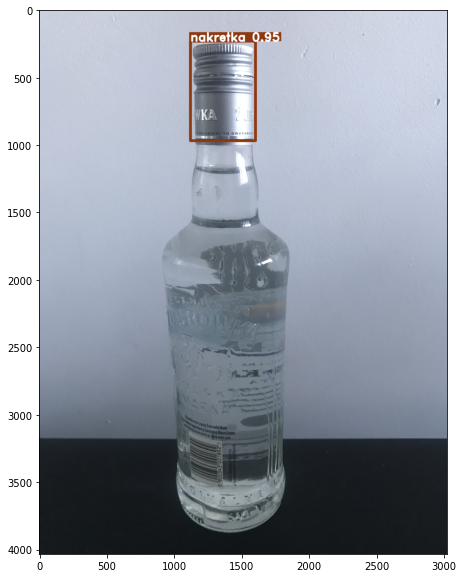

,x1,y1,x2,y2,class_name,score,w,h
0,1122,230,1604,968,nakretka,0.949572,482,738


In [11]:
yolo_model.predict("../../dataset/train_orig_images/brak_banderoli_nieoznaczone/IMG_5799.JPG")

In [ ]:
extract_top_from_orig(yolo_model, dirs, num_files = None)

[Errno 17] File exists: '../../dataset/butelka_wyciete_przez_niego/brak_banderoli'
../../dataset/train_orig_images/brak_banderoli/IMG_5388.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli/IMG_5084.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli/IMG_5297.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli/IMG_5269.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli/IMG_5194.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli/IMG_5107.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli/IMG_5111.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli/IMG_5024.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli/IMG_5117.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli/IMG_5324.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli/IMG_5112.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli/IMG_5304.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli/IMG_53

img shape:  (4032, 3024, 3)


2021-12-27 19:01:47.364443: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


In [ ]:
glob(os.path.join(IMAGE_PATH,'*'))

[Errno 17] File exists: '../../dataset/butelka_wyciete_przez_niego/brak_banderoli_nieoznaczone'
../../dataset/train_orig_images/brak_banderoli_nieoznaczone/IMG_5799.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli_nieoznaczone/IMG_5821.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli_nieoznaczone/IMG_5448.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli_nieoznaczone/IMG_5710.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli_nieoznaczone/IMG_5459.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli_nieoznaczone/IMG_5429.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli_nieoznaczone/IMG_5694.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli_nieoznaczone/IMG_5822.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli_nieoznaczone/IMG_5532.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli_nieoznaczone/IMG_5638.JPG
zrobiono: 0
../../dataset/train_orig_images/brak_banderoli_nieozna

img shape:  (4032, 3024, 3)
# of bboxes: 1


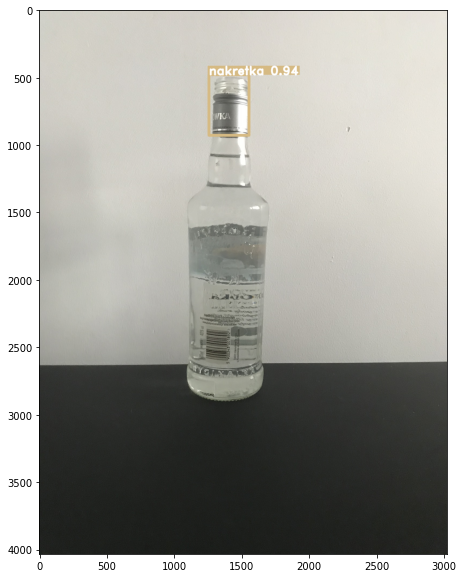

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7968.JPG
zrobiono: 1
img shape:  (4032, 3024, 3)
# of bboxes: 1


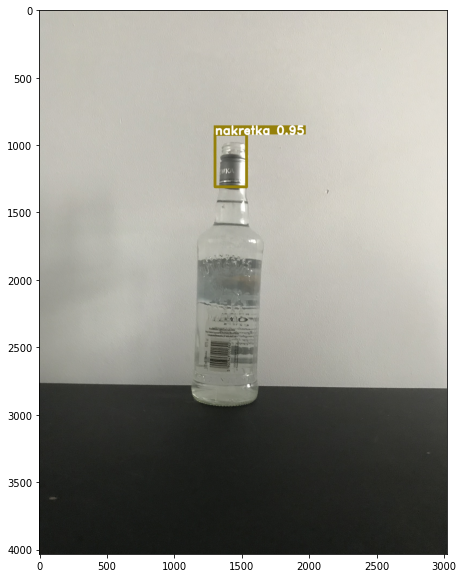

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7468.JPG
zrobiono: 2
img shape:  (4032, 3024, 3)
# of bboxes: 1


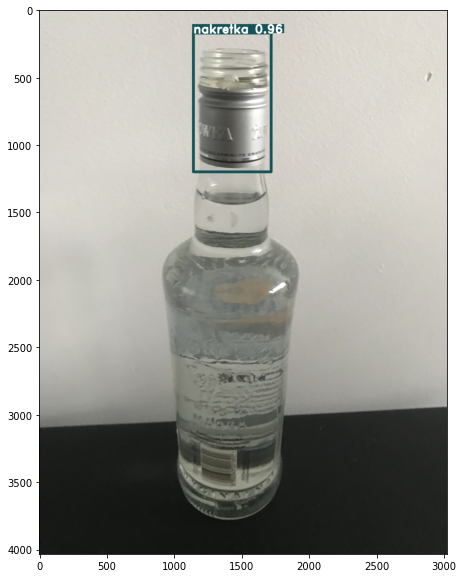

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7667.JPG
zrobiono: 3
img shape:  (4032, 3024, 3)
# of bboxes: 1


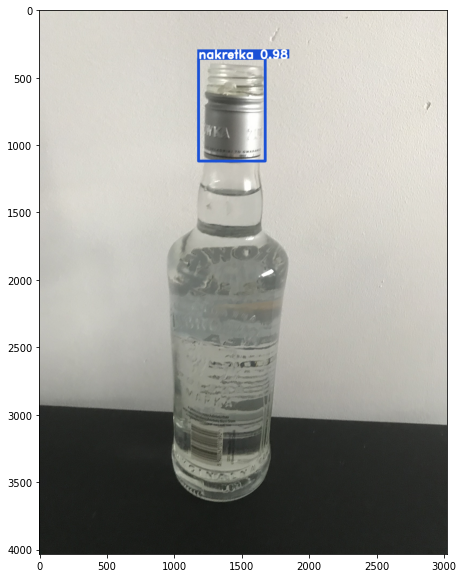

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7829.JPG
zrobiono: 4
img shape:  (4032, 3024, 3)
# of bboxes: 1


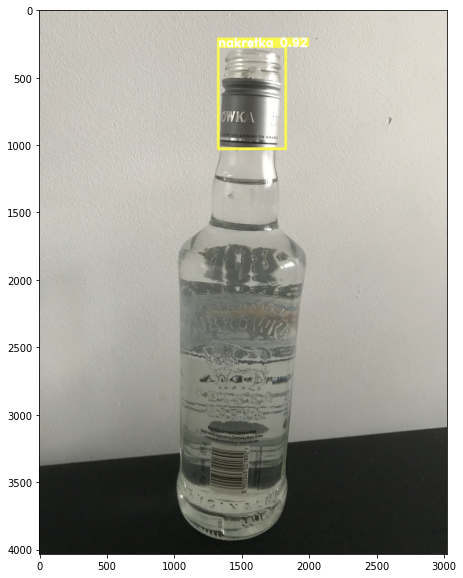

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7403.JPG
zrobiono: 5
img shape:  (4032, 3024, 3)
# of bboxes: 1


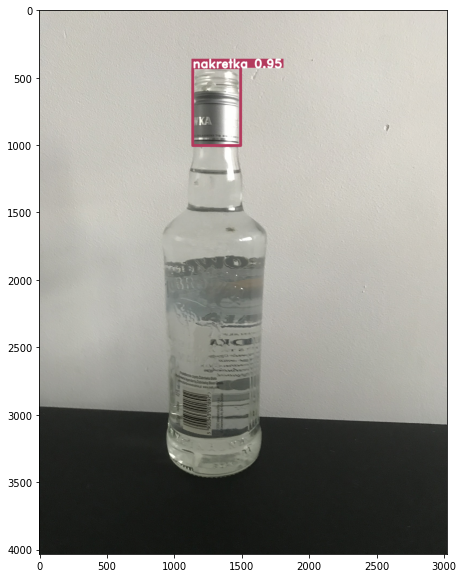

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7562.JPG
zrobiono: 6
img shape:  (4032, 3024, 3)
# of bboxes: 1


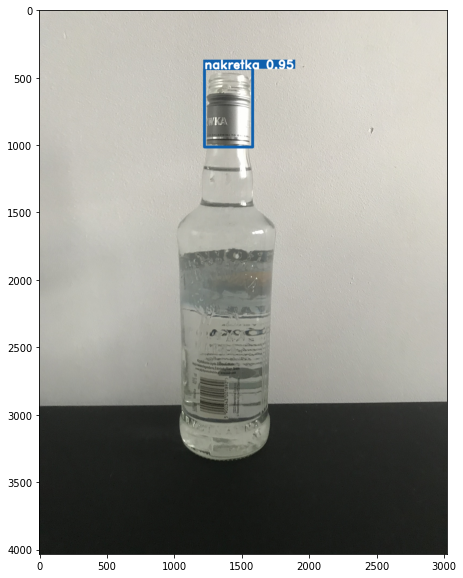

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7124.JPG
zrobiono: 7
img shape:  (4032, 3024, 3)
# of bboxes: 1


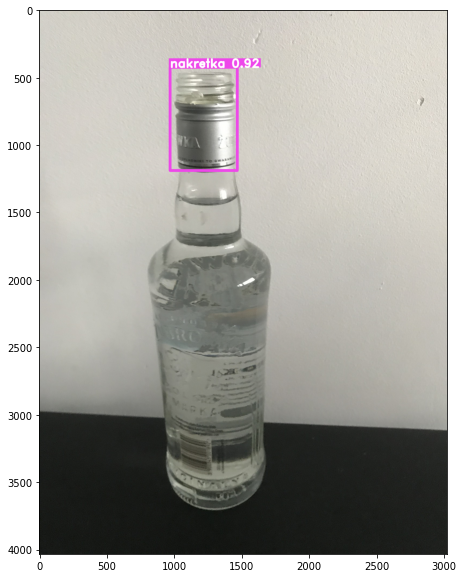

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7919.JPG
zrobiono: 8
img shape:  (4032, 3024, 3)
# of bboxes: 1


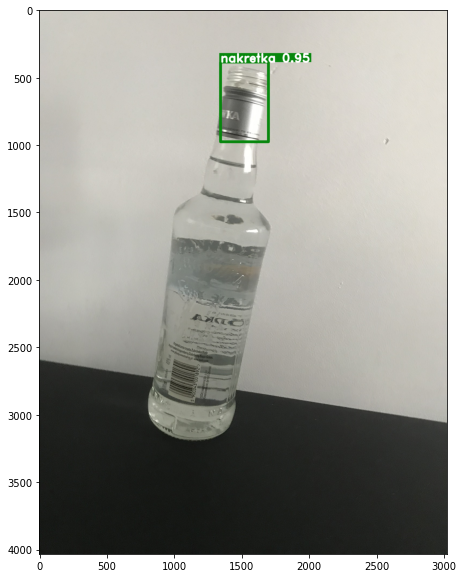

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7642.JPG
zrobiono: 9
img shape:  (4032, 3024, 3)
# of bboxes: 1


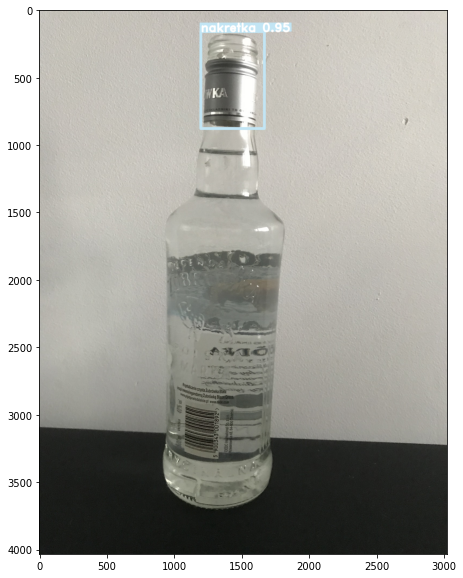

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7442.JPG
zrobiono: 10
img shape:  (4032, 3024, 3)
# of bboxes: 1


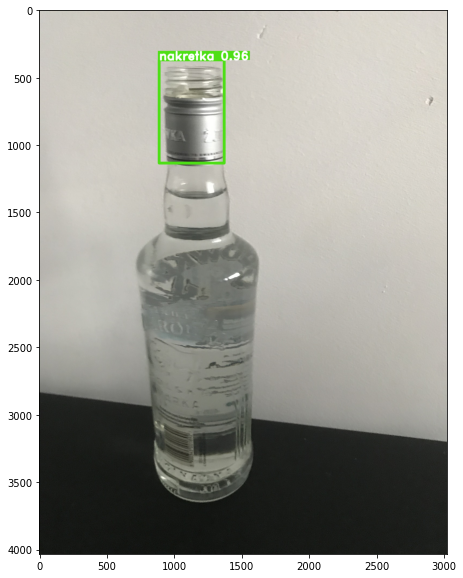

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7932.JPG
zrobiono: 11
img shape:  (4032, 3024, 3)
# of bboxes: 1


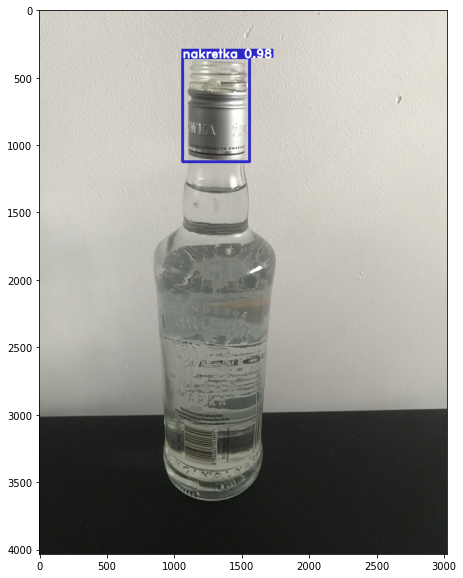

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7715.JPG
zrobiono: 12
img shape:  (4032, 3024, 3)
# of bboxes: 1


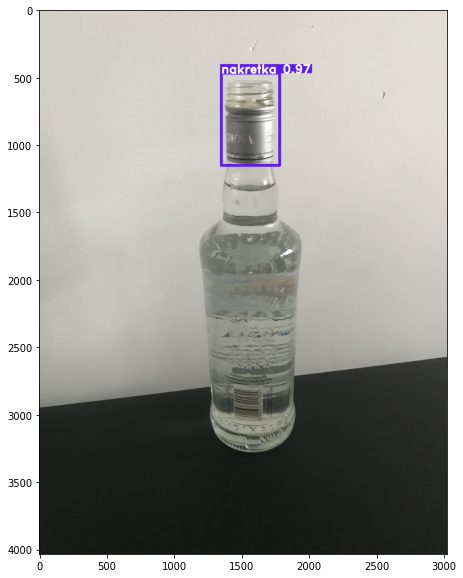

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7406.JPG
zrobiono: 13
img shape:  (4032, 3024, 3)
# of bboxes: 1


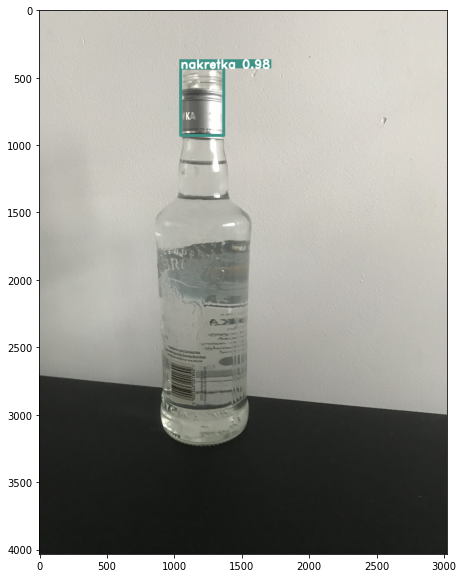

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7953.JPG
zrobiono: 14
img shape:  (4032, 3024, 3)
# of bboxes: 1


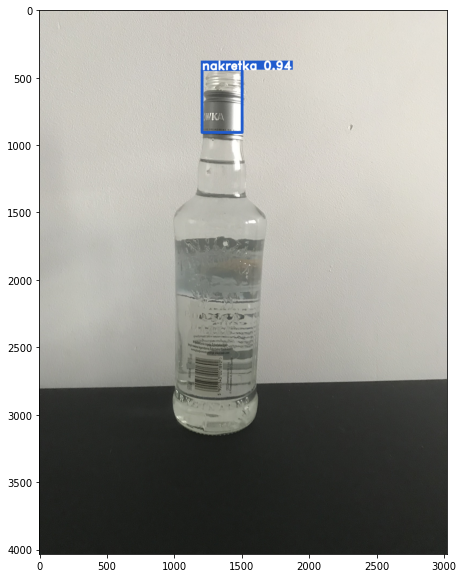

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7127.JPG
zrobiono: 15
img shape:  (4032, 3024, 3)
# of bboxes: 1


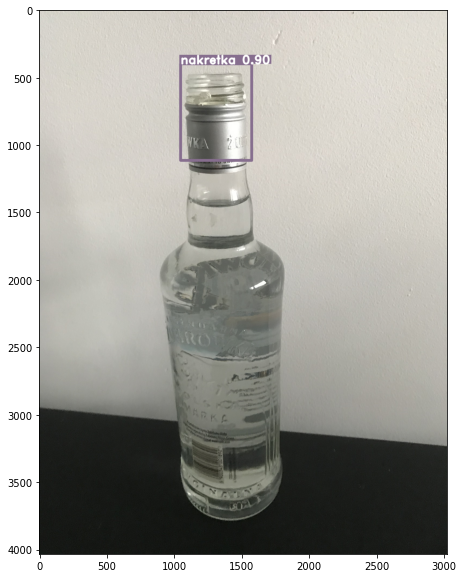

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7076.JPG
zrobiono: 16
img shape:  (4032, 3024, 3)
# of bboxes: 1


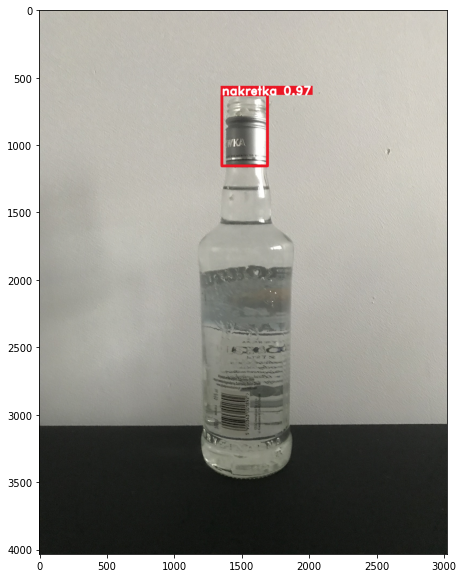

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7034.JPG
zrobiono: 17
img shape:  (4032, 3024, 3)
# of bboxes: 1


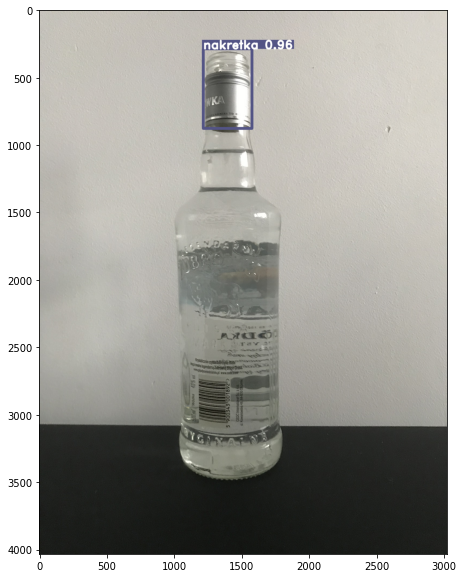

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7285.JPG
zrobiono: 18
img shape:  (4032, 3024, 3)
# of bboxes: 1


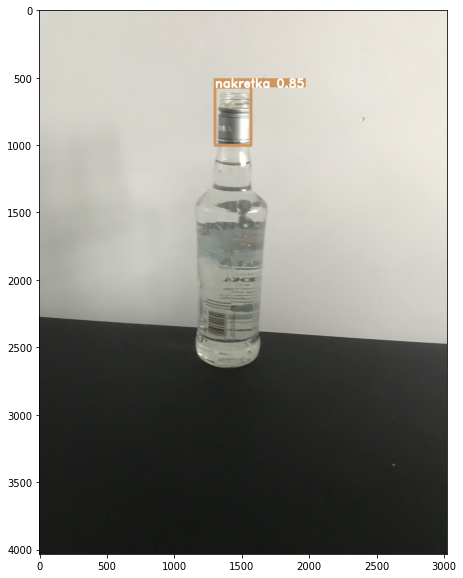

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7600.JPG
zrobiono: 19
img shape:  (4032, 3024, 3)
# of bboxes: 1


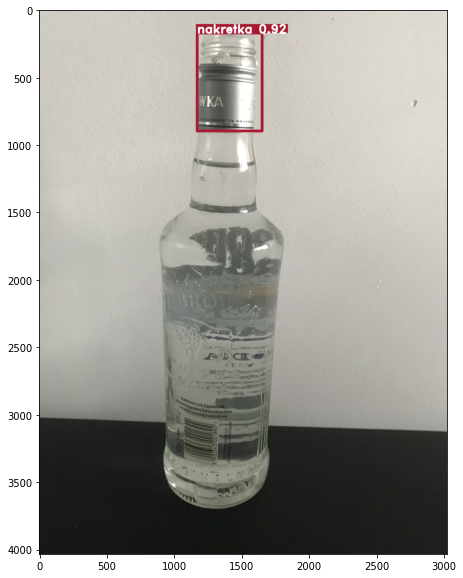

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7213.JPG
zrobiono: 20
img shape:  (4032, 3024, 3)
# of bboxes: 1


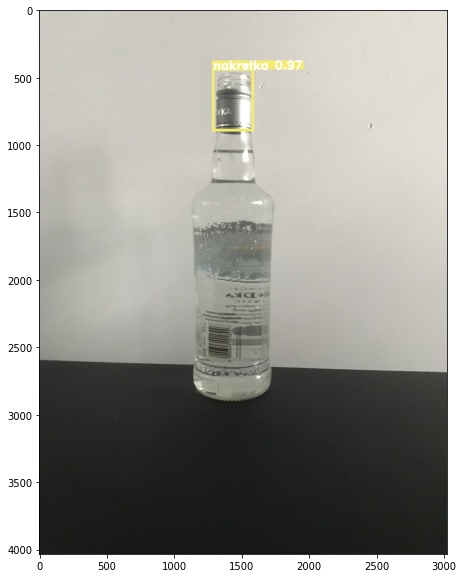

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7897.JPG
zrobiono: 21
img shape:  (4032, 3024, 3)
# of bboxes: 1


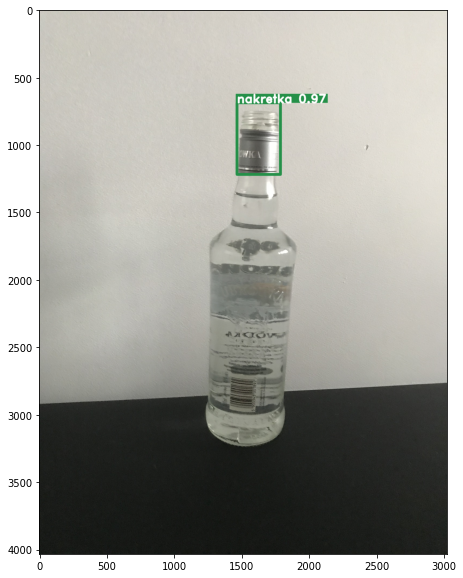

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_8029.JPG
zrobiono: 22
img shape:  (4032, 3024, 3)
# of bboxes: 1


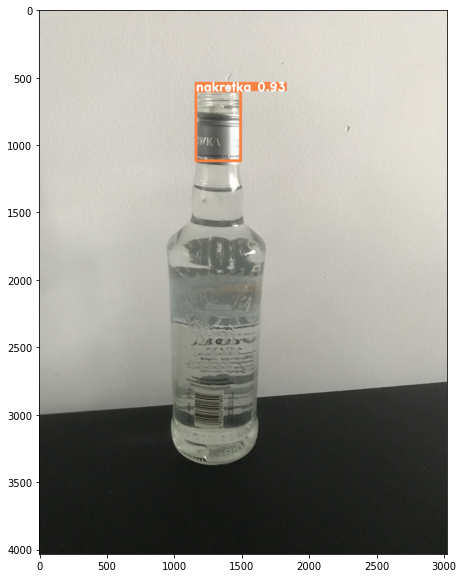

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7789.JPG
zrobiono: 23
img shape:  (4032, 3024, 3)
# of bboxes: 1


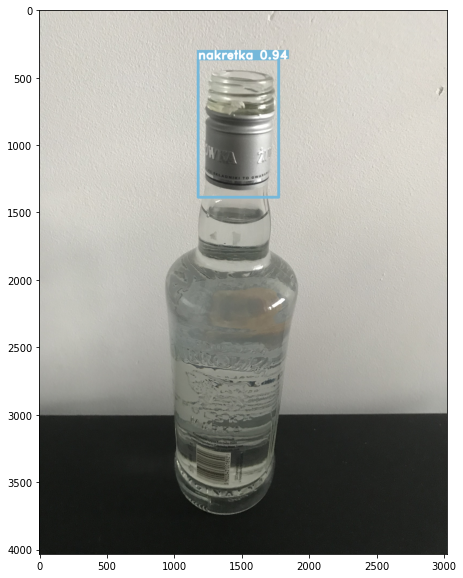

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7174.JPG
zrobiono: 24
img shape:  (4032, 3024, 3)
# of bboxes: 1


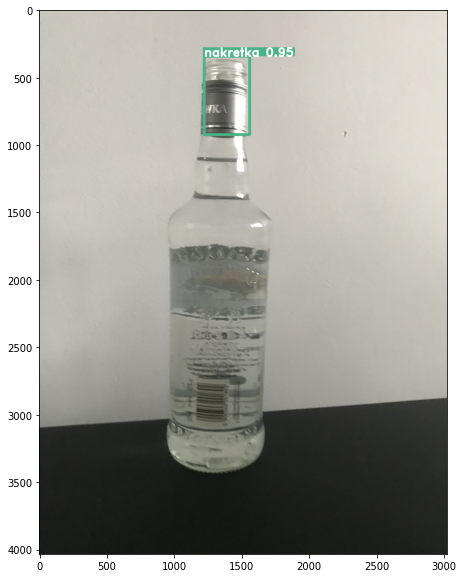

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7299.JPG
zrobiono: 25
img shape:  (4032, 3024, 3)
# of bboxes: 1


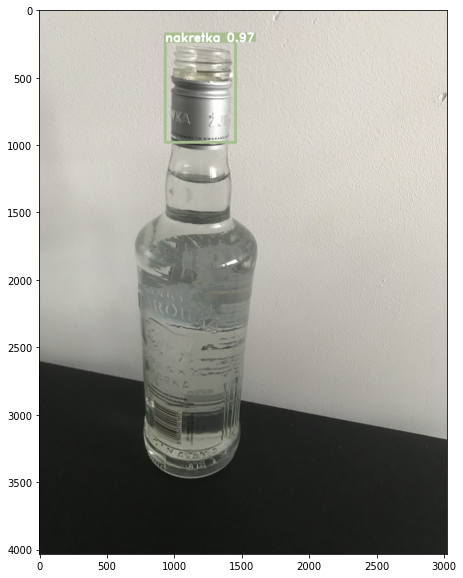

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7208.JPG
zrobiono: 26
img shape:  (4032, 3024, 3)
# of bboxes: 1


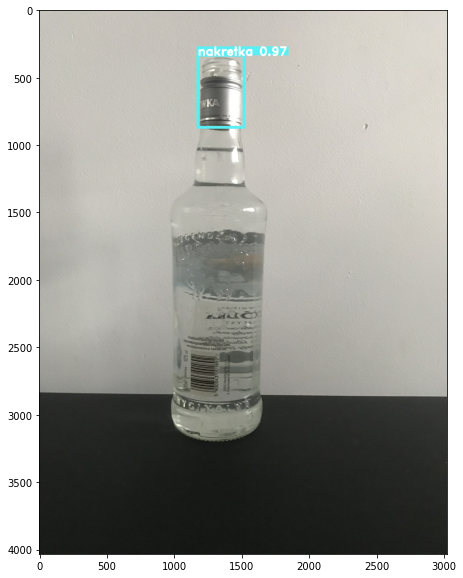

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7539.JPG
zrobiono: 27
img shape:  (4032, 3024, 3)
# of bboxes: 1


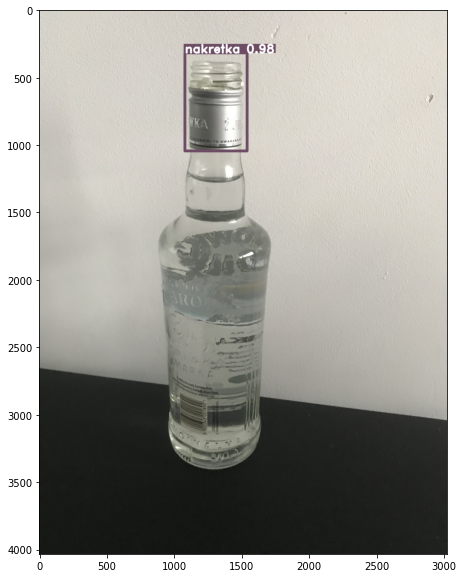

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7570.JPG
zrobiono: 28
img shape:  (4032, 3024, 3)
# of bboxes: 1


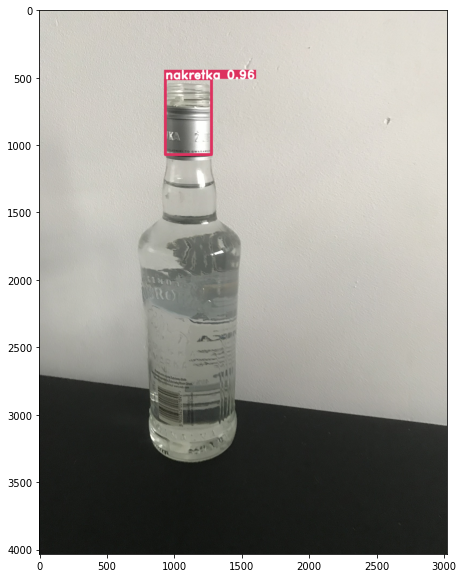

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7371.JPG
zrobiono: 29
img shape:  (4032, 3024, 3)
# of bboxes: 1


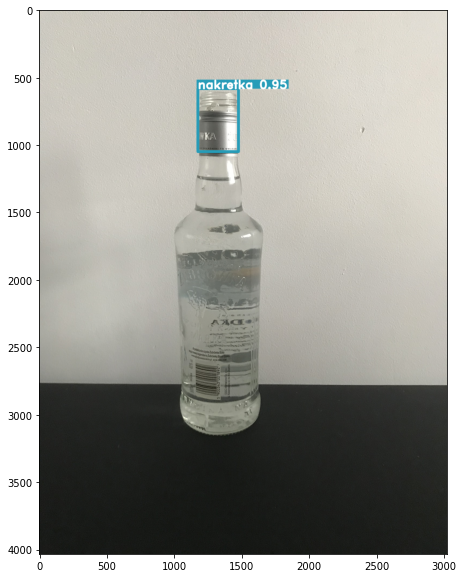

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7913.JPG
zrobiono: 30
img shape:  (4032, 3024, 3)
# of bboxes: 1


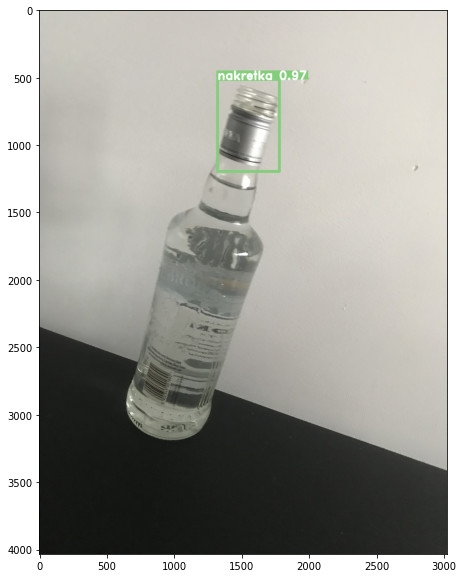

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7879.JPG
zrobiono: 31
img shape:  (4032, 3024, 3)
# of bboxes: 1


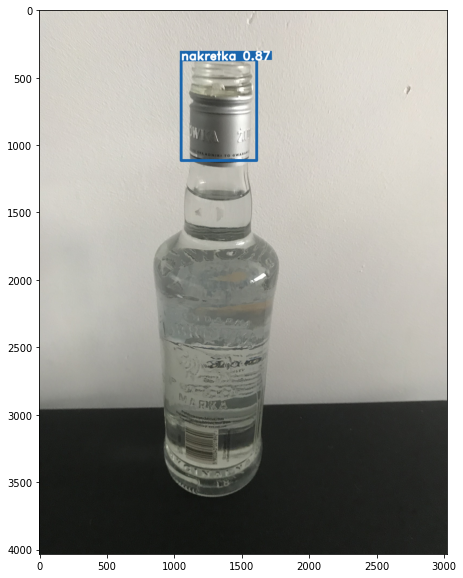

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7177.JPG
zrobiono: 32
img shape:  (4032, 3024, 3)
# of bboxes: 1


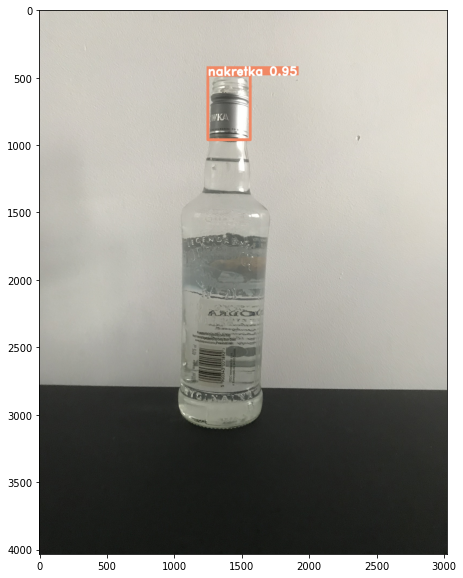

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7771.JPG
zrobiono: 33
img shape:  (4032, 3024, 3)
# of bboxes: 1


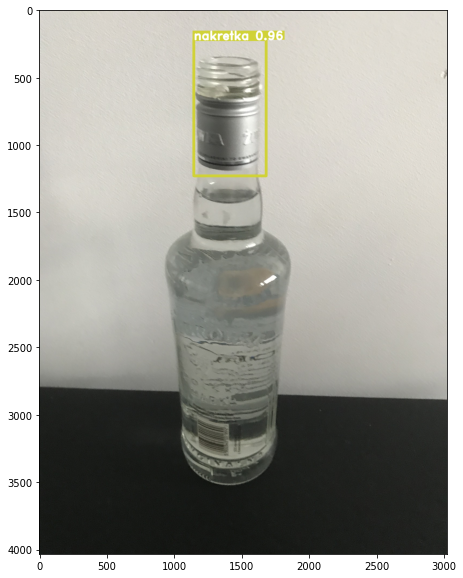

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7999.JPG
zrobiono: 34
img shape:  (4032, 3024, 3)
# of bboxes: 1


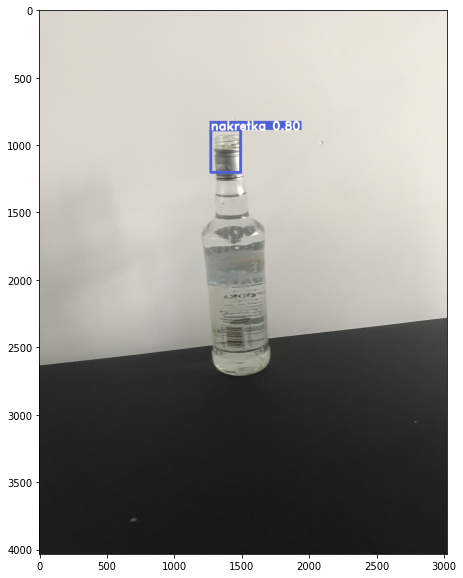

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7855.JPG
zrobiono: 35
img shape:  (4032, 3024, 3)
# of bboxes: 1


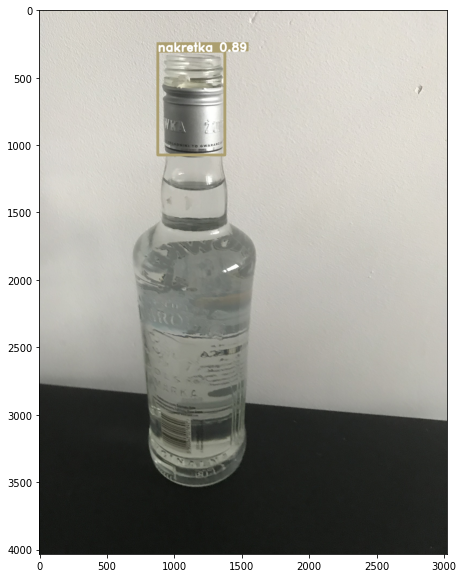

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7546.JPG
zrobiono: 36
img shape:  (4032, 3024, 3)
# of bboxes: 1


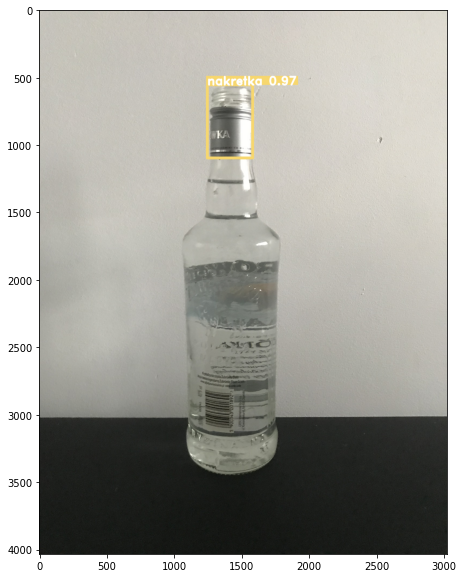

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7991.JPG
zrobiono: 37
img shape:  (4032, 3024, 3)
# of bboxes: 1


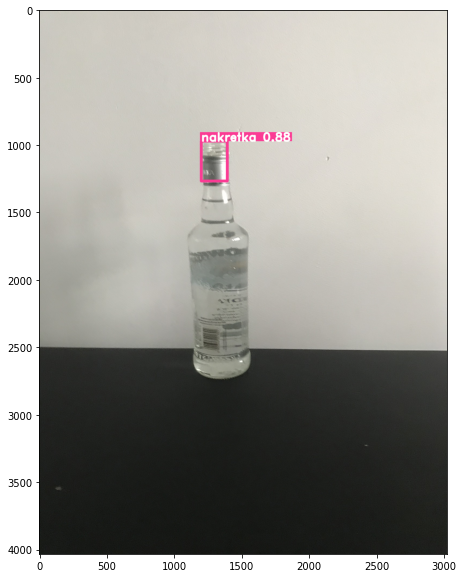

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7973.JPG
zrobiono: 38
img shape:  (4032, 3024, 3)
# of bboxes: 1


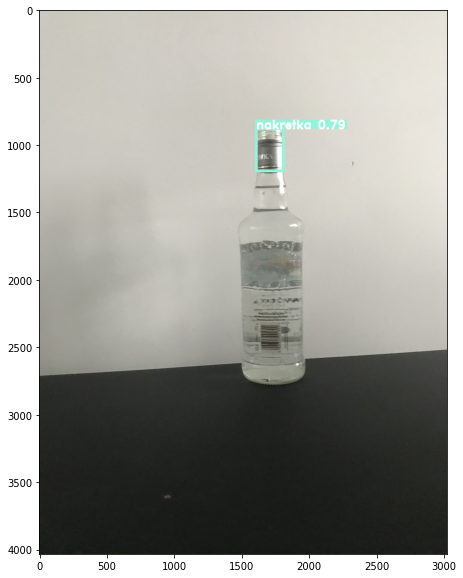

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7428.JPG
zrobiono: 39
img shape:  (4032, 3024, 3)
# of bboxes: 1


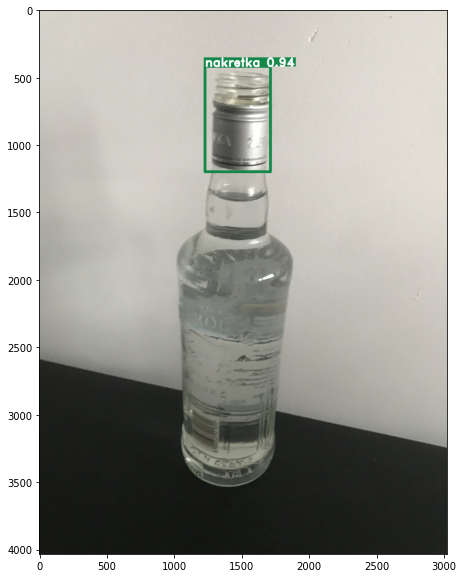

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7536.JPG
zrobiono: 40
img shape:  (4032, 3024, 3)
# of bboxes: 1


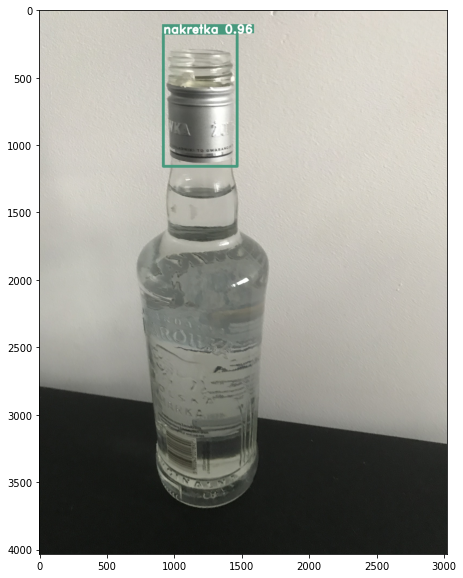

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7930.JPG
zrobiono: 41
img shape:  (4032, 3024, 3)
# of bboxes: 1


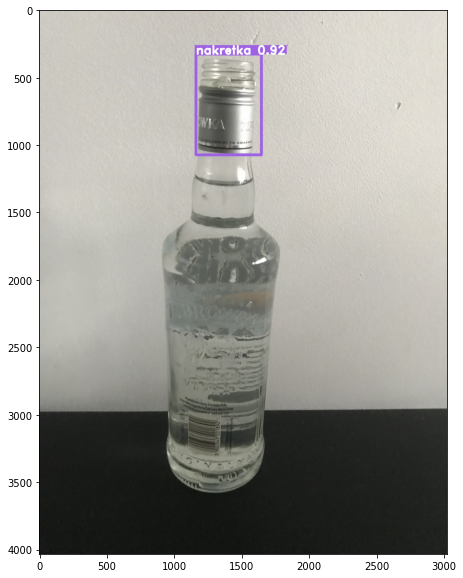

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7767.JPG
zrobiono: 42
img shape:  (4032, 3024, 3)
# of bboxes: 1


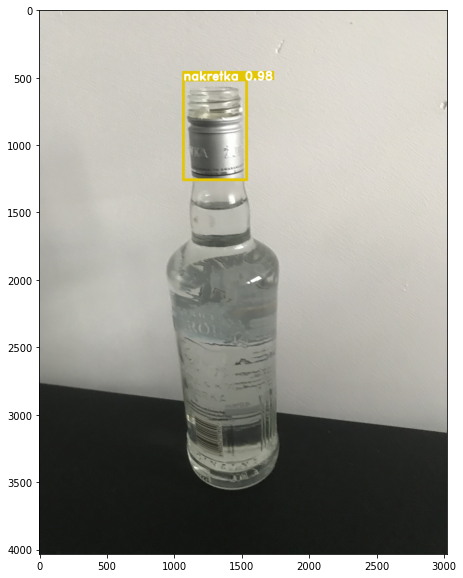

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7965.JPG
zrobiono: 43
img shape:  (4032, 3024, 3)
# of bboxes: 1


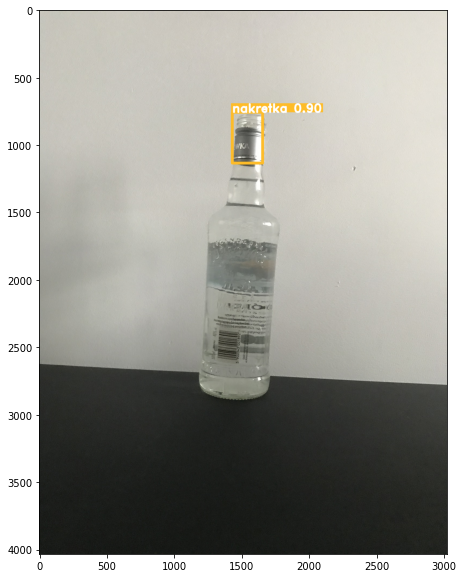

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7554.JPG
zrobiono: 44
img shape:  (4032, 3024, 3)
# of bboxes: 1


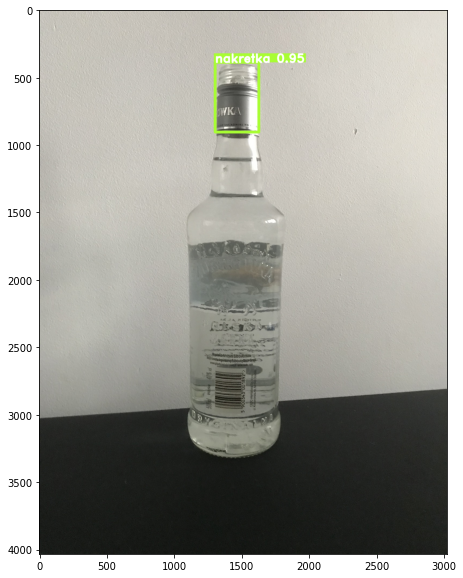

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7589.JPG
zrobiono: 45
img shape:  (4032, 3024, 3)
# of bboxes: 1


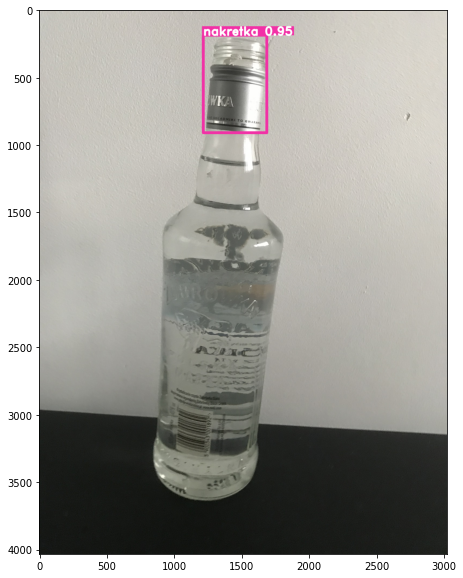

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7314.JPG
zrobiono: 46
img shape:  (4032, 3024, 3)
# of bboxes: 1


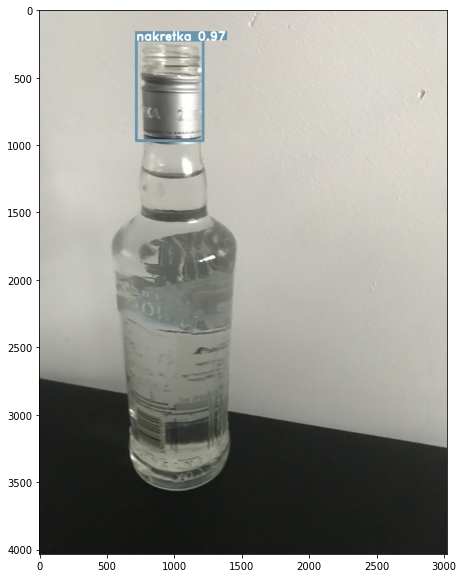

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7934.JPG
zrobiono: 47
img shape:  (4032, 3024, 3)
# of bboxes: 1


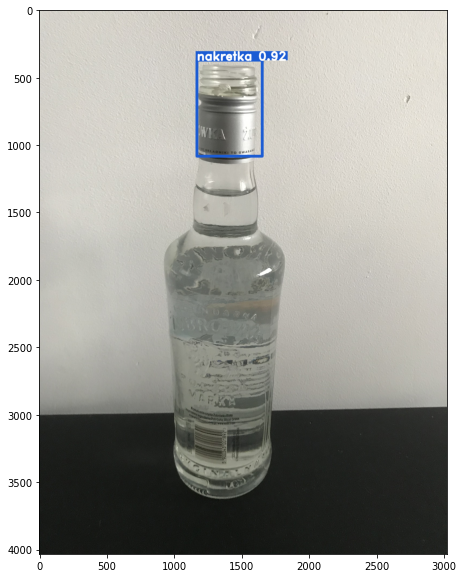

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7785.JPG
zrobiono: 48
img shape:  (4032, 3024, 3)
# of bboxes: 1


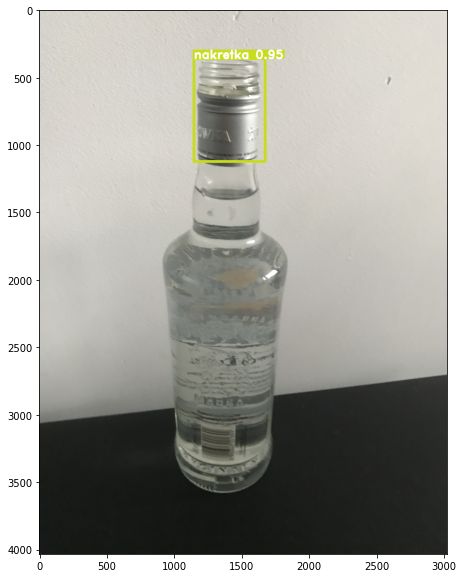

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7151.JPG
zrobiono: 49
img shape:  (4032, 3024, 3)
# of bboxes: 1


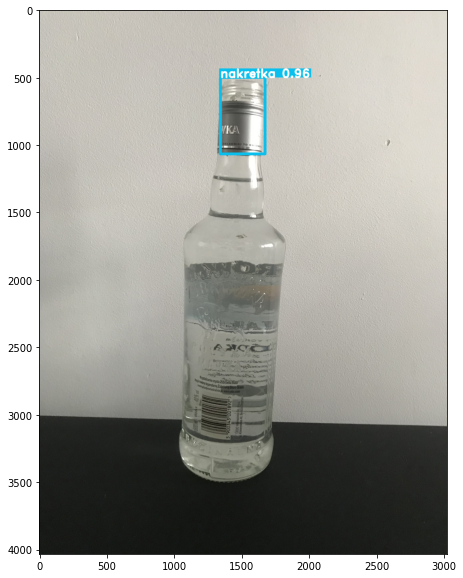

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7892.JPG
zrobiono: 50
img shape:  (4032, 3024, 3)
# of bboxes: 2


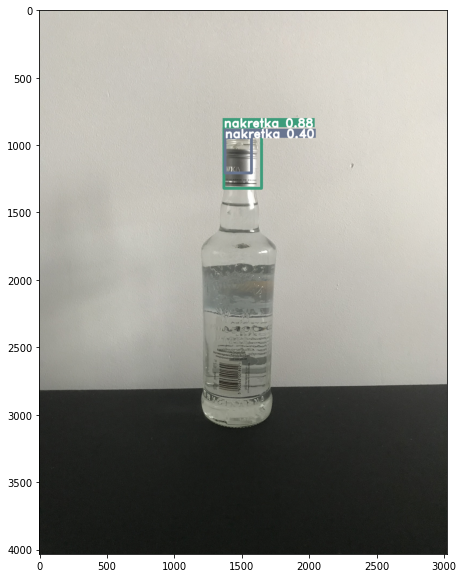

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7880.JPG
zrobiono: 51
img shape:  (4032, 3024, 3)
# of bboxes: 1


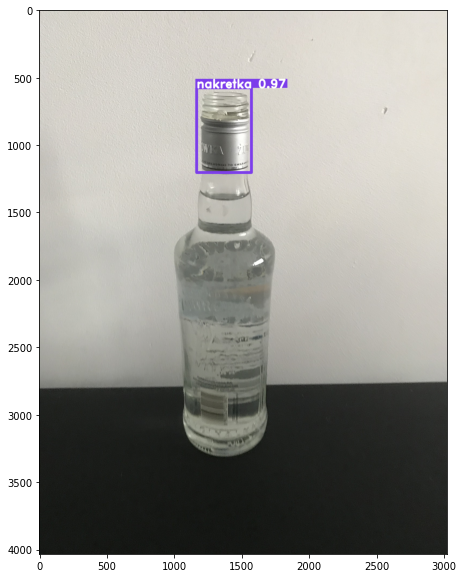

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7090.JPG
zrobiono: 52
img shape:  (4032, 3024, 3)
# of bboxes: 1


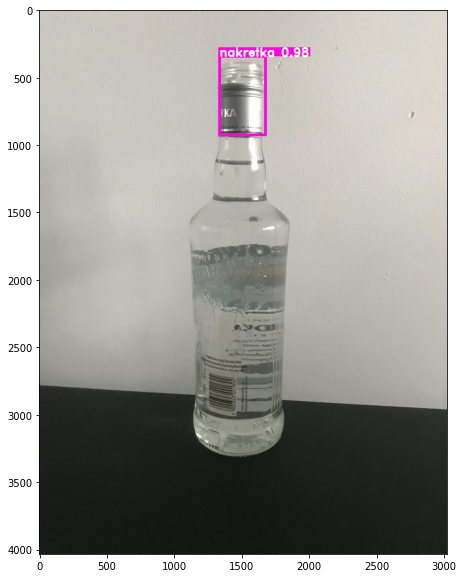

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7300.JPG
zrobiono: 53
img shape:  (4032, 3024, 3)
# of bboxes: 1


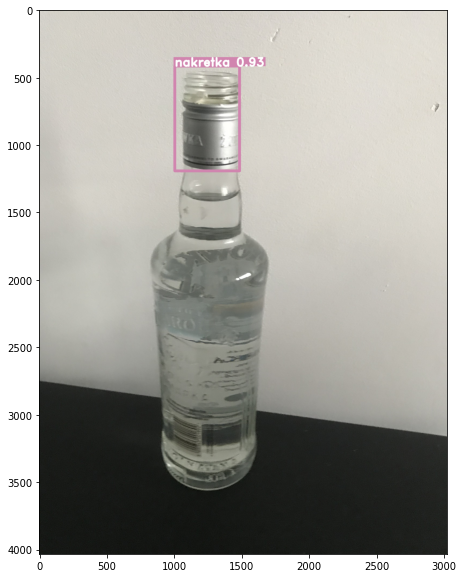

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7575.JPG
zrobiono: 54
img shape:  (4032, 3024, 3)
# of bboxes: 1


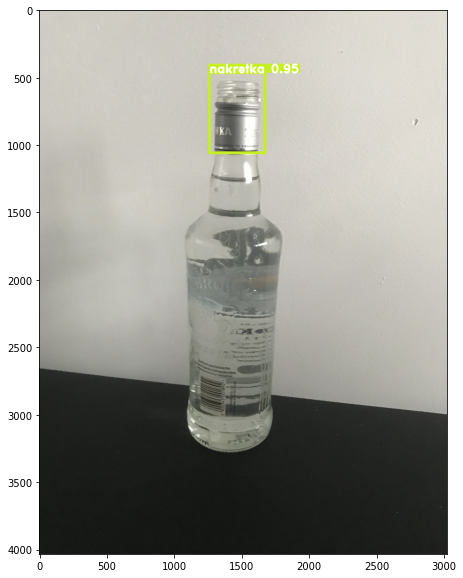

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7926.JPG
zrobiono: 55
img shape:  (4032, 3024, 3)
# of bboxes: 1


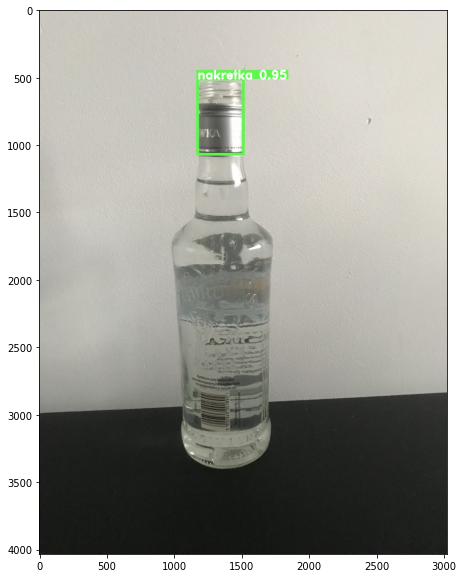

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7799.JPG
zrobiono: 56
img shape:  (4032, 3024, 3)
# of bboxes: 1


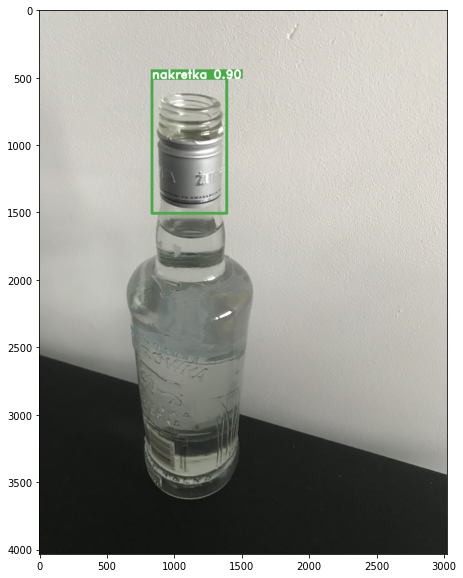

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7707.JPG
zrobiono: 57
img shape:  (4032, 3024, 3)
# of bboxes: 1


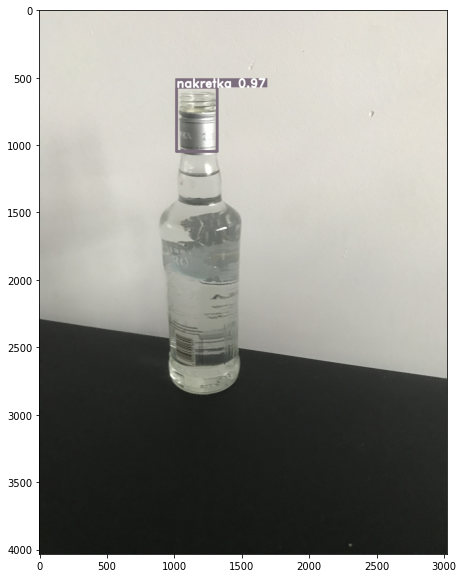

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7370.JPG
zrobiono: 58
img shape:  (4032, 3024, 3)
# of bboxes: 1


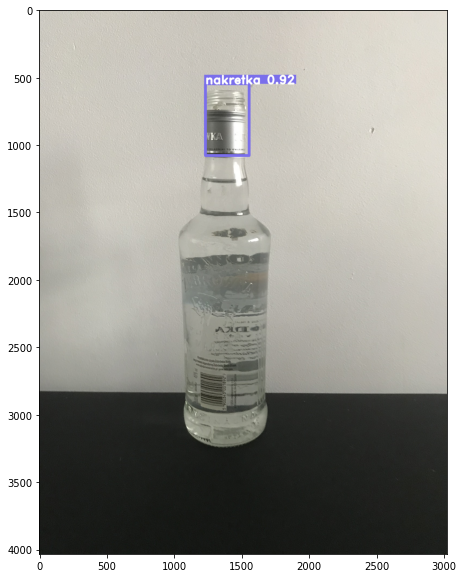

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7528.JPG
zrobiono: 59
img shape:  (4032, 3024, 3)
# of bboxes: 1


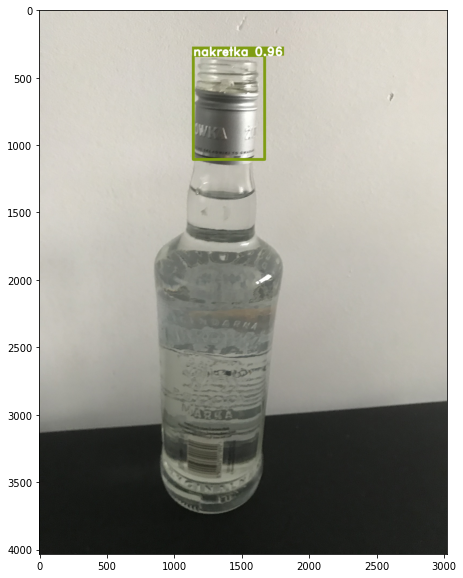

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7413.JPG
zrobiono: 60
img shape:  (4032, 3024, 3)
# of bboxes: 1


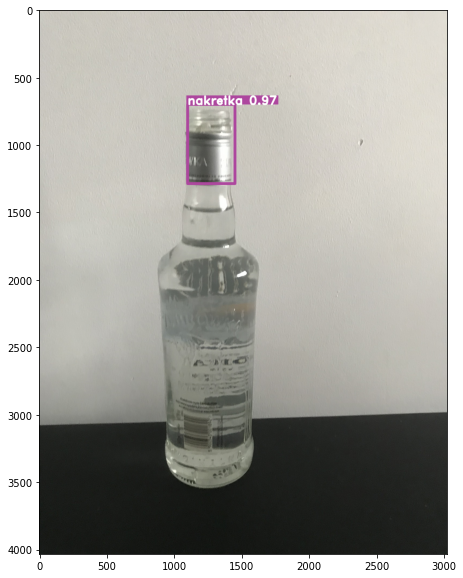

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7637.JPG
zrobiono: 61
img shape:  (4032, 3024, 3)
# of bboxes: 1


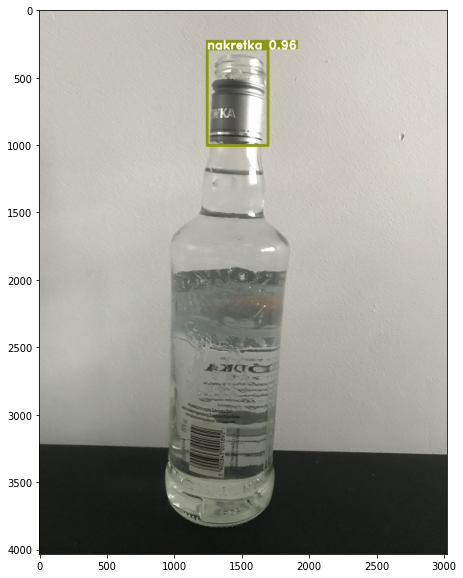

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7967.JPG
zrobiono: 62
img shape:  (4032, 3024, 3)
# of bboxes: 1


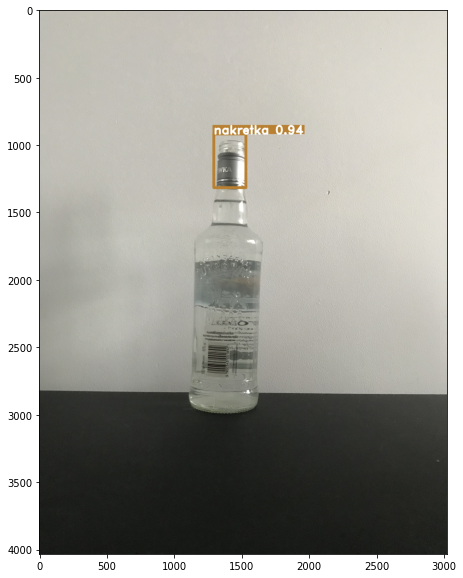

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7881.JPG
zrobiono: 63
img shape:  (4032, 3024, 3)
# of bboxes: 1


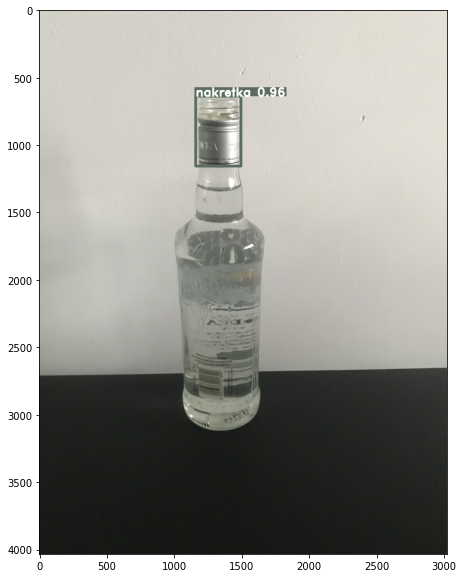

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7803.JPG
zrobiono: 64
img shape:  (4032, 3024, 3)
# of bboxes: 1


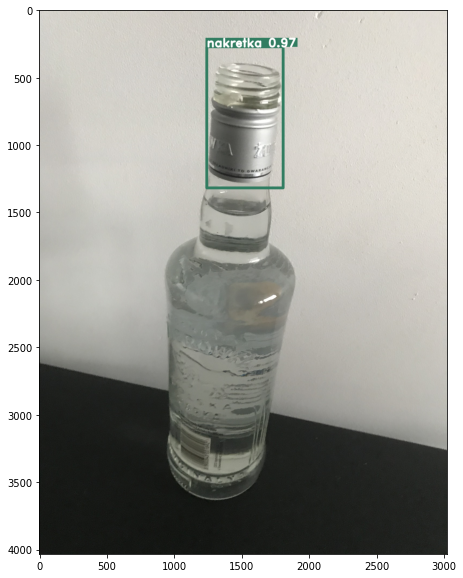

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7651.JPG
zrobiono: 65
img shape:  (4032, 3024, 3)
# of bboxes: 1


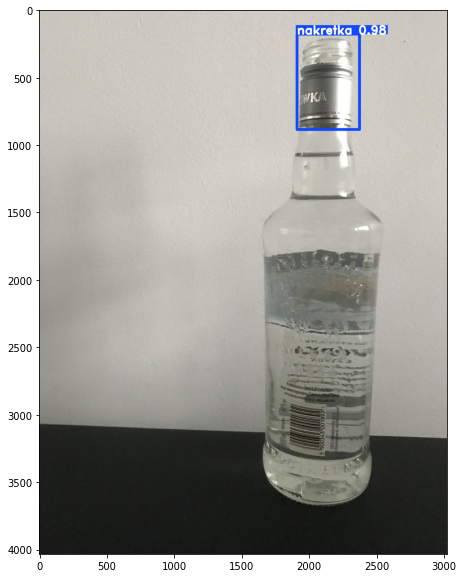

../../dataset/train_orig_images/brak_nakretki_nieoznaczone/IMG_7698.JPG
zrobiono: 66
img shape:  (4032, 3024, 3)
# of bboxes: 1


In [ ]:
extract_top_from_orig(yolo_model, dirs, num_files = None)